In [1]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt


In [3]:
df = pd.read_pickle('df_allInfo_clean.pkl')

In [6]:
info = df.info()
info

<class 'pandas.core.frame.DataFrame'>
Index: 503 entries, A to ON
Data columns (total 75 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   heldPercentInstitutions       503 non-null    float64
 1   ebitdaMargins                 503 non-null    float64
 2   grossProfits                  503 non-null    float64
 3   recommendationKey             503 non-null    object 
 4   operatingMargins              503 non-null    float64
 5   grossMargins                  503 non-null    float64
 6   profitMargins                 503 non-null    float64
 7   industry                      503 non-null    object 
 8   shortName                     503 non-null    object 
 9   country                       503 non-null    object 
 10  revenuePerShare               503 non-null    float64
 11  exchange                      503 non-null    object 
 12  city                          503 non-null    object 
 13  sharesShort

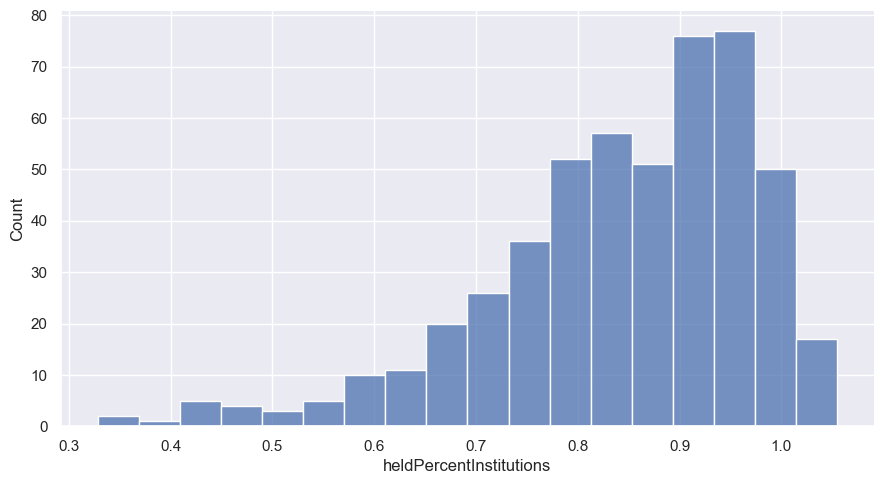

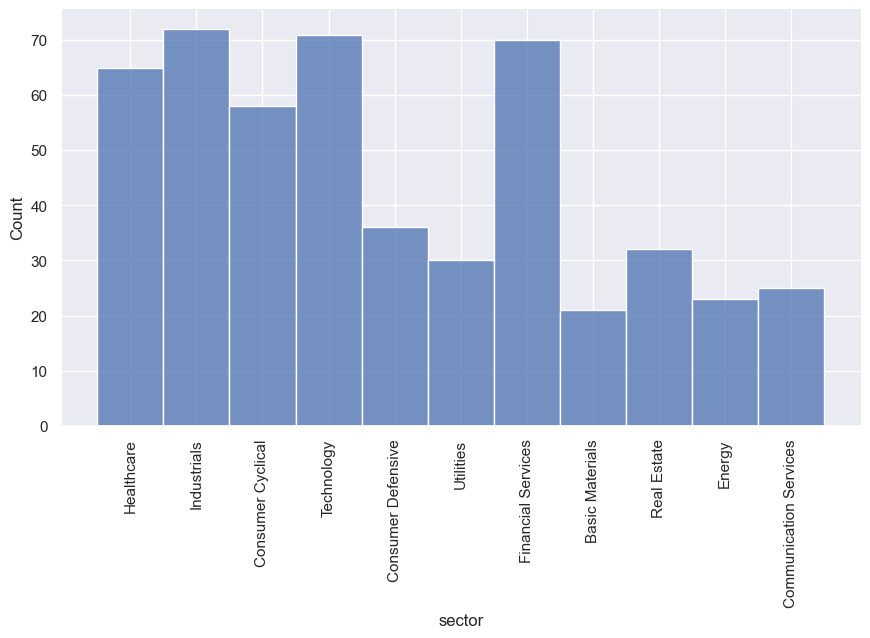

In [7]:
sns.set()
sns.displot(df.heldPercentInstitutions, aspect=1.8);
sns.displot(df.sector, aspect=1.8);
plt.xticks(rotation=90);


'sector' is identified as an important company data charecteristic which can be used for subsetting the data. 

In [10]:
data = df.sector.value_counts()
data

Industrials               72
Technology                71
Financial Services        70
Healthcare                65
Consumer Cyclical         58
Consumer Defensive        36
Real Estate               32
Utilities                 30
Communication Services    25
Energy                    23
Basic Materials           21
Name: sector, dtype: int64

In [11]:
data.values.sum()

503

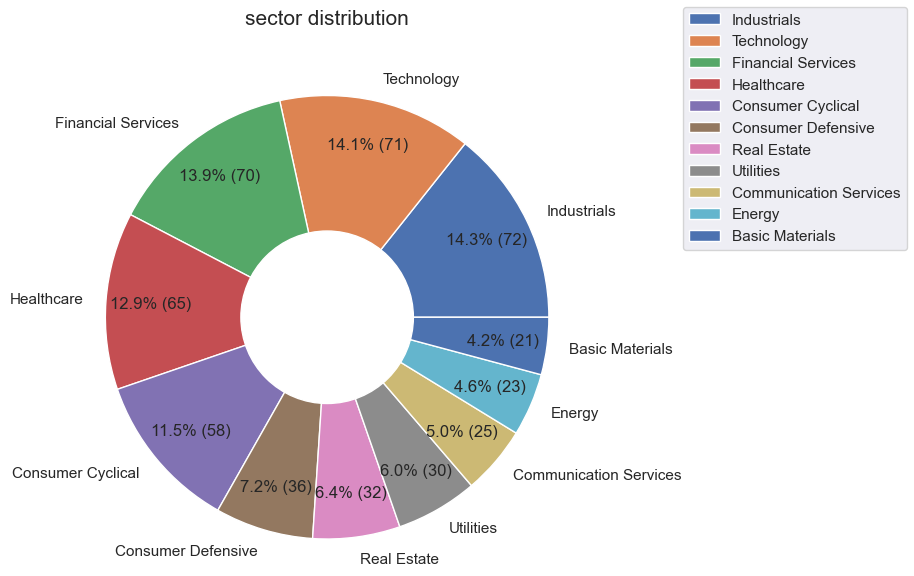

In [12]:
qual_var = 'sector'
data = df[qual_var].value_counts()
plt.pie(x=data.values, labels=data.index, autopct= lambda p: f'{p:.1f}% ({p*data.values.sum()/100:.0f})', pctdistance=0.8, radius=1.8);
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
plt.title(f'{qual_var} distribution', pad=100, fontsize=15);
fig.set_size_inches(12, 4);
fig.legend(loc=1);
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle);
#not fit for pie: city, industry, numberOfAnalystOpinions, state, lastSplitFactor
#totalDebt, sharesOutstanding -> change to number format

In [13]:
#not fit for pie: city, industry, numberOfAnalystOpinions, state, lastSplitFactor
#top 10 most frequent aspect
top = 10
cols = ['city', 'industry', 'state', 'lastSplitFactor']
ser_col = dict()
for c in cols:
    data = df[c]
    ser = data.value_counts()
    ##other = data.value_counts().sum() - data.value_counts().head(top).sum()
    #ser = pd.concat([ser.head(top), pd.Series(other, index = ['others'])], axis=0)
    display(ser)
    ser_col[c] = ser.head(top)
    #display(f'others: {data.value_counts().sum() - data.value_counts().head(top).sum()}')
    #display(data.describe())

New York           41
Houston            21
Atlanta            16
Chicago            14
Dallas             11
                   ..
Juno Beach          1
Brentwood           1
Palo Alto           1
Highlands Ranch     1
Durham              1
Name: city, Length: 232, dtype: int64

Utilities—Regulated Electric       23
Specialty Industrial Machinery     18
Banks—Regional                     14
Semiconductors                     14
Information Technology Services    12
                                   ..
Business Equipment & Supplies       1
Security & Protection Services      1
Insurance—Specialty                 1
Consumer Electronics                1
Utilities—Renewable                 1
Name: industry, Length: 114, dtype: int64

CA    68
NY    54
TX    47
IL    32
MA    23
OH    21
PA    20
GA    18
FL    16
NC    16
NJ    15
VA    15
MN    14
WA    13
CT    12
MI    11
CO     9
TN     8
MD     7
IN     7
AZ     7
WI     7
MO     6
RI     4
NV     4
OK     4
AR     3
LA     3
KY     3
DE     2
NE     2
AL     2
ID     2
UT     2
DC     2
ME     1
OR     1
IA     1
Name: state, dtype: int64

2:1          203
3:2           41
3:1           23
4:1           11
10:1           5
            ... 
11:10          1
25:10          1
1275:1000      1
1:32           1
1017:1000      1
Name: lastSplitFactor, Length: 94, dtype: int64

In [14]:
#check the dataframe format before automating the plot for all the similar features
# pd.DataFrame(ser_col['city'].reset_index()).rename(columns={'index':'prop'})
pd.DataFrame(ser_col['city'].reset_index(), columns=['index', 'city']).rename(columns={'index':'prop', 'city': 'value'})

,prop,value
0,New York,41
1,Houston,21
2,Atlanta,16
3,Chicago,14
4,Dallas,11
5,Dublin,10
6,San Jose,8
7,Charlotte,8
8,Santa Clara,8
9,Boston,7


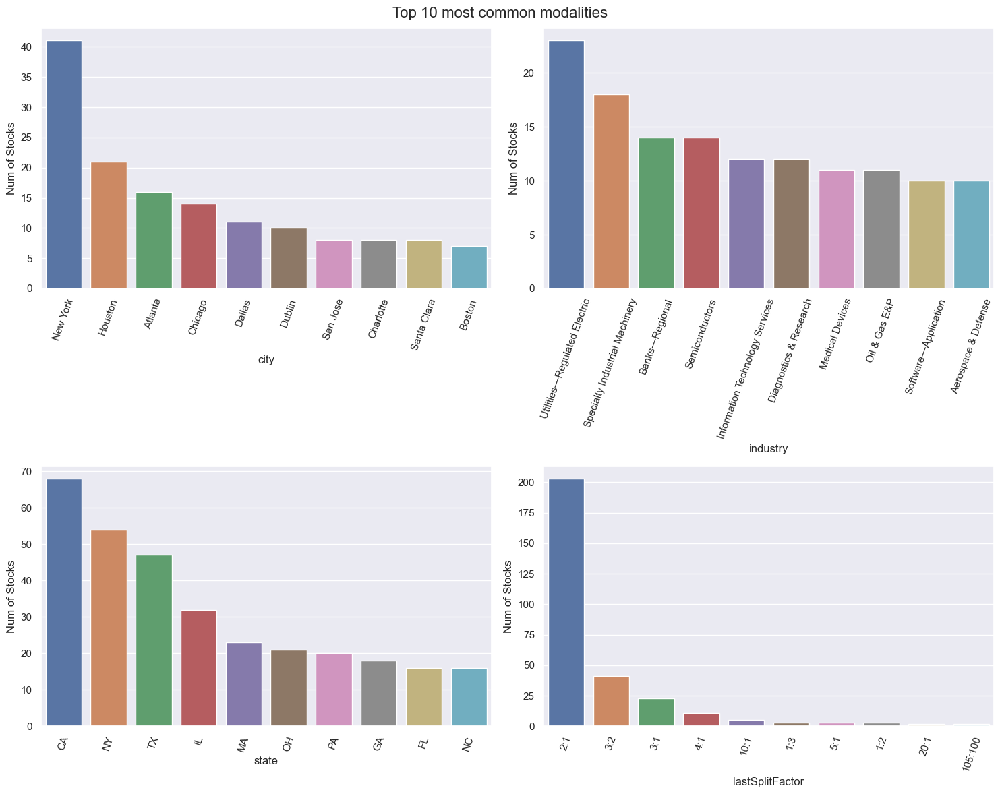

In [15]:
f, a = plt.subplots(2, 2)
f.set_size_inches(15, 12)
row = 0
col = 0
for k, v in ser_col.items():
    ax_curr = a[row, col]
    data = pd.DataFrame(ser_col[k].reset_index(), columns=['index', k])\
                                       .rename(columns={'index':'prop', k: 'value'})

    sns.barplot(x=data.prop, y=data.value, ax=ax_curr)
    ax_curr.set_xlabel(k)
    ax_curr.set_ylabel('Num of Stocks')
    ax_curr.tick_params(axis='x', rotation=70)
    if col == 1:
        row = 1
    col = int(not bool(col))
f.suptitle('Top 10 most common modalities', fontsize=16)
f.set_tight_layout(True)



In [16]:
qual_var = 'marketCap'
data = df[qual_var]
display(data.value_counts())
display(data.describe())

45250048000     1
42156711936     1
91746705408     1
83230531584     1
55842541568     1
               ..
69839077376     1
58711699456     1
8960510976      1
198003507200    1
30386720768     1
Name: marketCap, Length: 498, dtype: int64

count             498
unique            498
top       45250048000
freq                1
Name: marketCap, dtype: int64

In [17]:
ind_sec_count = df.groupby('sector').industry.value_counts()
ind_sec_count = pd.DataFrame(ind_sec_count)

In [18]:
ind_sec_count = ind_sec_count.rename(columns={'industry': 'count_industry'})

In [19]:
ind_sec_count= ind_sec_count.reset_index()
ind_sec_count

,sector,industry,count_industry
0,Basic Materials,Specialty Chemicals,10
1,Basic Materials,Agricultural Inputs,4
2,Basic Materials,Building Materials,2
3,Basic Materials,Chemicals,2
4,Basic Materials,Copper,1
...,...,...,...
109,Utilities,Utilities—Diversified,2
110,Utilities,Utilities—Regulated Gas,2
111,Utilities,Utilities—Independent Power Producers,1
112,Utilities,Utilities—Regulated Water,1


In [21]:
ind_sector = df[['sector', 'industry']]\
                .drop_duplicates()\
                .groupby('sector')\
                .agg('count')\
                .sort_values(by='industry', ascending=False)\
                .rename(columns={'industry': 'industry_counts_by_sector'})\
                .reset_index()
ind_sector

,sector,industry_counts_by_sector
0,Consumer Cyclical,19
1,Industrials,19
2,Financial Services,12
3,Consumer Defensive,11
4,Technology,11
5,Healthcare,10
6,Real Estate,9
7,Basic Materials,7
8,Utilities,6
9,Communication Services,5


Industry count per sector

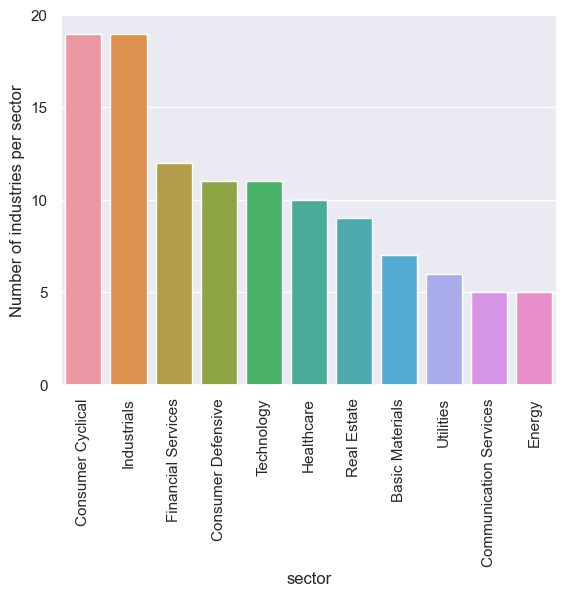

In [22]:
sns.barplot(data=ind_sector, x='sector', y='industry_counts_by_sector');
plt.xticks(rotation=90);
plt.ylabel('Number of industries per sector');
plt.yticks(range(0, 25, 5));

Top 5 industry per sector

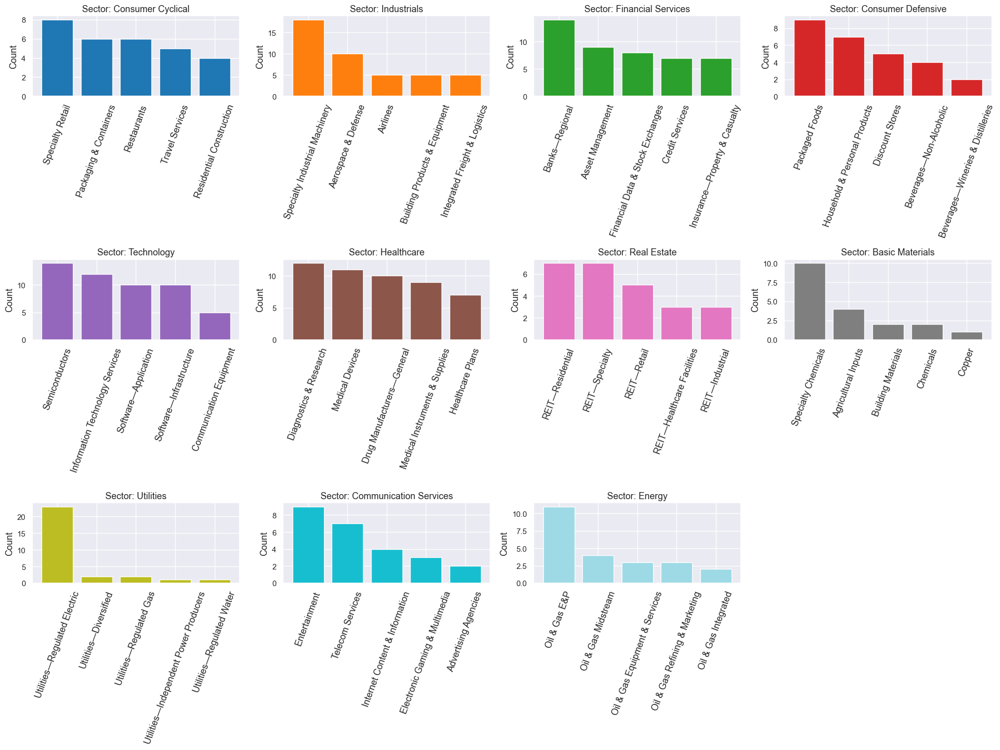

In [23]:
def get_cmap(n, name='tab20'):
    '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
    RGB color; the keyword argument name must be a standard mpl colormap name.'''
    return plt.cm.get_cmap(name, n)
cmap = get_cmap(len(ind_sector))
fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(20, 15))
row = 0
col = 0
for i, sec in enumerate(ind_sector.sector):
    filter_sec = ind_sec_count[ind_sec_count.sector == sec].head(5)
    ax[row, col].bar(filter_sec.industry, filter_sec.count_industry, color=cmap(i));
    ax[row, col].tick_params(axis='x', labelsize=13, labelrotation=70)
    ax[row, col].set_title(f'Sector: {sec}', fontsize=13)
    ax[row, col].set_ylabel('Count', fontsize=13)

    if i%4 == 3:
        col = 0
        row = row + 1
    else:
        col = col + 1

fig.tight_layout();  
fig.delaxes(ax[2, 3])  
    #print(i, sec)


Test a kde plot for a numerical varaiable, will be automated for producing and saving all such variables later.

count    503.000000
mean       0.250820
std        0.174447
min       -0.369920
25%        0.136240
50%        0.228460
75%        0.339840
max        0.922680
Name: ebitdaMargins, dtype: float64

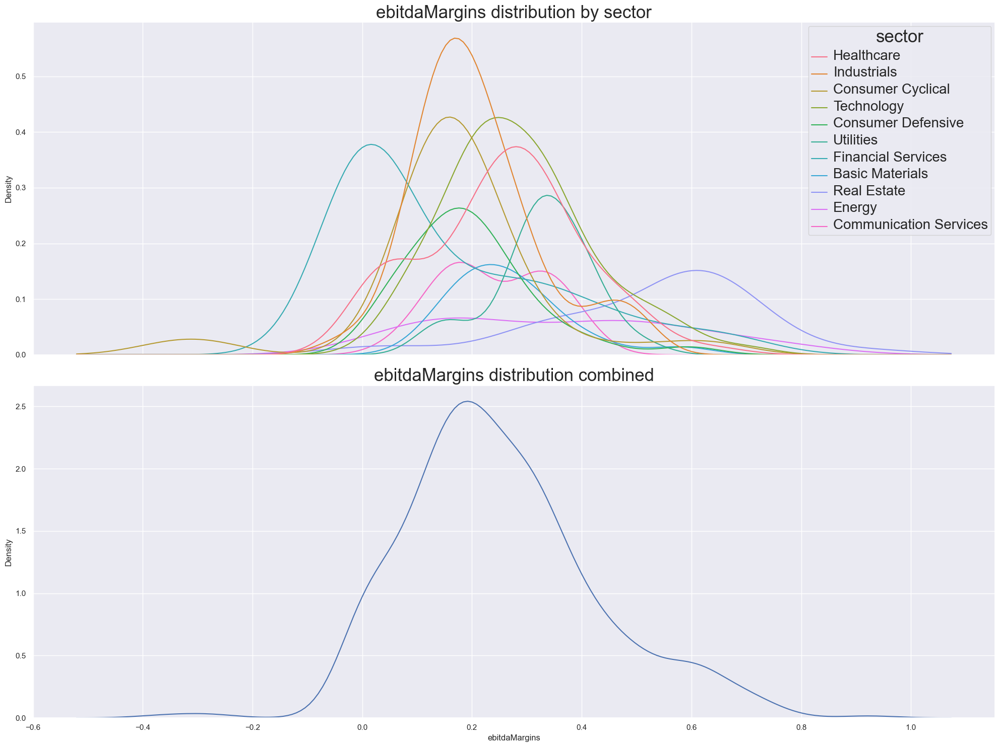

In [24]:
display(df.ebitdaMargins.describe())
f, axs = plt.subplots(2,1, figsize=(20, 15),
                      sharex=True)
axs_0 = sns.kdeplot(data=df, x='ebitdaMargins', hue='sector', ax=axs[0], common_norm=True, common_grid=True);
plt.setp(axs_0.get_legend().get_texts(), fontsize='20');
plt.setp(axs_0.get_legend().get_title(), fontsize='25');
axs_0.set_title('ebitdaMargins distribution by sector', fontsize=25); 
axs_1 = sns.kdeplot(data=df, x='ebitdaMargins', ax=axs[1], common_norm=True, common_grid=True);
axs_1.set_title('ebitdaMargins distribution combined', fontsize=25); 
f.tight_layout();

count     225.0000
unique    225.0000
top         2.3275
freq        1.0000
Name: trailingPegRatio, dtype: float64

TypeError: The x variable is categorical, but one of ['numeric', 'datetime'] is required

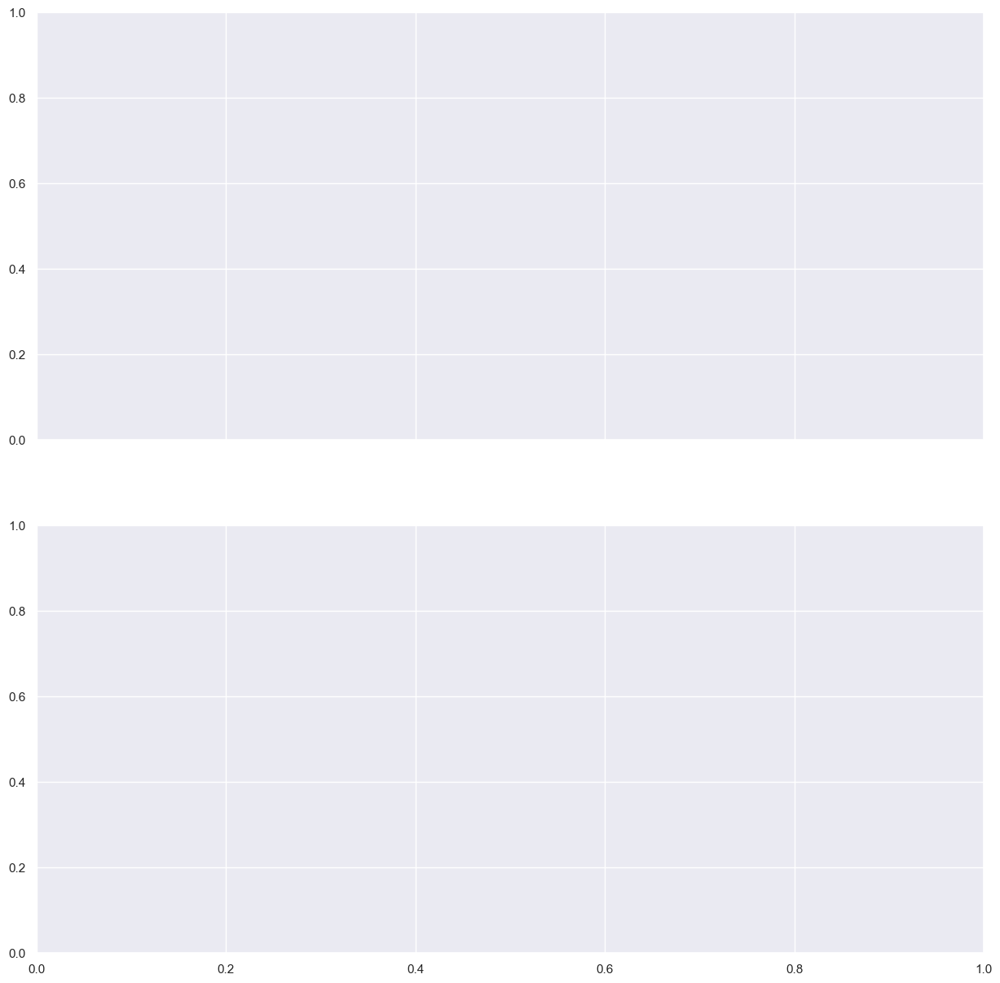

In [26]:
var = 'trailingPegRatio'
display(df[var].describe())
f, axs = plt.subplots(2,1, figsize=(15, 15),
                      sharex=True)
axs_0 = sns.kdeplot(data=df, x=var, hue='sector', ax=axs[0], common_norm=True, common_grid=True);
plt.setp(axs_0.get_legend().get_texts(), fontsize='20');
plt.setp(axs_0.get_legend().get_title(), fontsize='25');
axs_0.set_title(f'{var} distribution by sector', fontsize=25); 
axs_1 = sns.kdeplot(data=df, x=var, ax=axs[1], common_norm=True, common_grid=True);
axs_1.set_title(f'{var} distribution combined', fontsize=25); 
f.tight_layout();

understanding the error shows we have object data types for some numeric ones

In [27]:
df.trailingPegRatio.info()

<class 'pandas.core.series.Series'>
Index: 503 entries, A to ON
Series name: trailingPegRatio
Non-Null Count  Dtype 
--------------  ----- 
225 non-null    object
dtypes: object(1)
memory usage: 24.0+ KB


some object columns need to be fixed of data types

In [28]:
df_obj = df.reset_index().select_dtypes(include='object')
df_obj.columns

Index(['symbol', 'recommendationKey', 'industry', 'shortName', 'country',
       'exchange', 'city', 'sector', 'currency', 'sharesOutstanding',
       'totalDebt', 'marketCap', 'netIncomeToCommon', 'totalCash',
       'floatShares', 'totalRevenue', 'numberOfAnalystOpinions', 'state',
       'operatingCashflow', 'priceToBook', 'ebitda', 'trailingPE',
       'freeCashflow', 'dividendYield', 'dividendRate', 'lastSplitFactor',
       'fiveYearAvgDividendYield', 'lastDividendValue', 'trailingPegRatio'],
      dtype='object')

In [29]:
#real obj cols
real_obj_cols = ['symbol', 'recommendationKey', 'industry', 'shortName', 'country',
       'exchange', 'city', 'sector', 'currency', 
       #'sharesOutstanding',
       #'totalDebt', 'marketCap', 'netIncomeToCommon', 'totalCash',
       #'floatShares', 'totalRevenue', 
       'numberOfAnalystOpinions', 'state',
       #,
       #'operatingCashflow', 'priceToBook', 'ebitda', 'trailingPE',
       #'freeCashflow', 'dividendYield', 'dividendRate', 
       'lastSplitFactor'#,
       #'fiveYearAvgDividendYield', 'lastDividendValue', 'trailingPegRatio'
       ]
df_obj_num = df_obj[list(set(df_obj.columns) - set(real_obj_cols))]

df_obj_num = df_obj_num.apply(pd.to_numeric)

In [30]:
df_obj_num

,lastDividendValue,ebitda,fiveYearAvgDividendYield,priceToBook,totalDebt,trailingPegRatio,dividendYield,marketCap,operatingCashflow,floatShares,freeCashflow,sharesOutstanding,netIncomeToCommon,trailingPE,dividendRate,totalRevenue,totalCash
0,0.21,1.935000e+09,0.72,8.555412,2.769000e+09,2.3275,0.0058,4.525005e+10,1.312000e+09,2.939439e+08,7.777500e+08,2.950000e+08,1.254000e+09,36.696175,0.90,6.848000e+09,1.053000e+09
1,0.10,2.400000e+09,NaN,NaN,4.468200e+10,NaN,NaN,8.916642e+09,1.131000e+09,6.429469e+08,2.655000e+08,6.499010e+08,-1.608000e+09,NaN,NaN,4.521000e+10,1.123200e+10
2,1.50,1.012869e+09,0.79,3.215064,4.086856e+09,0.9405,0.0392,8.735773e+09,6.704200e+08,5.857667e+07,2.133401e+08,5.925370e+07,4.768450e+08,18.901281,6.00,1.107795e+10,1.912040e+08
3,0.23,1.305410e+11,0.99,44.323475,1.324800e+11,2.8596,0.0063,2.258845e+12,1.221510e+11,1.589141e+10,9.021525e+10,1.590810e+10,9.980300e+10,23.054008,0.92,3.943280e+11,4.830400e+10
4,1.41,2.940100e+10,4.35,18.251880,6.999900e+10,NaN,0.0362,2.919230e+11,2.259000e+10,1.766624e+09,1.995050e+10,1.768480e+09,1.334300e+10,22.009335,5.92,5.781900e+10,1.188100e+10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
498,NaN,7.312348e+09,0.68,1.467710,5.722699e+09,NaN,0.0189,2.681506e+10,1.771879e+09,2.643793e+08,7.352500e+08,2.718520e+08,4.431329e+09,9.048155,1.50,3.193020e+10,1.360415e+09
499,NaN,1.056300e+09,1.33,3.793303,2.118500e+09,NaN,0.0161,1.326532e+10,5.004000e+08,1.054672e+08,7.806125e+08,1.066430e+08,2.104000e+08,29.729923,2.00,3.643500e+09,4.418000e+08
500,NaN,2.137594e+09,3.32,1.805080,1.712222e+10,NaN,0.0488,3.035386e+10,NaN,2.869657e+08,NaN,2.837870e+08,1.400868e+09,68.432500,4.88,4.512797e+09,1.769690e+08
501,NaN,2.760000e+09,NaN,6.711619,1.265300e+10,NaN,NaN,3.983757e+10,2.392000e+09,1.843117e+08,1.420750e+09,1.910400e+08,1.182000e+09,99.300000,NaN,1.430700e+10,1.361000e+09


In [31]:
df_numTypesUpdated = pd.concat([df_obj[real_obj_cols], df_obj_num, df.reset_index()[list(set(df.reset_index().columns) - set(df_obj.columns))]], axis=1)

check if we dont have any inconsistancies

In [32]:
a = set(df_obj[real_obj_cols].columns) 
b = set(df_obj_num.columns) 
c = set(df.reset_index()[list(set(df.reset_index().columns) - set(df_obj.reset_index().columns))].columns)

In [33]:
c.intersection(a)

set()

In [34]:
df_numTypesUpdated.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 503 entries, 0 to 502
Data columns (total 76 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   symbol                        503 non-null    object 
 1   recommendationKey             503 non-null    object 
 2   industry                      503 non-null    object 
 3   shortName                     503 non-null    object 
 4   country                       503 non-null    object 
 5   exchange                      503 non-null    object 
 6   city                          503 non-null    object 
 7   sector                        503 non-null    object 
 8   currency                      502 non-null    object 
 9   numberOfAnalystOpinions       489 non-null    object 
 10  state                         482 non-null    object 
 11  lastSplitFactor               383 non-null    object 
 12  lastDividendValue             266 non-null    float64
 13  ebitd

In [206]:
df_numTypesUpdated.to_pickle('df_allInfo_clean_typesCorrected.pkl')

test saving of figures into local drive

count    496.000000
mean       0.070333
std        0.057693
min       -0.064950
25%        0.028260
50%        0.056660
75%        0.096518
max        0.352550
Name: returnOnAssets, dtype: float64

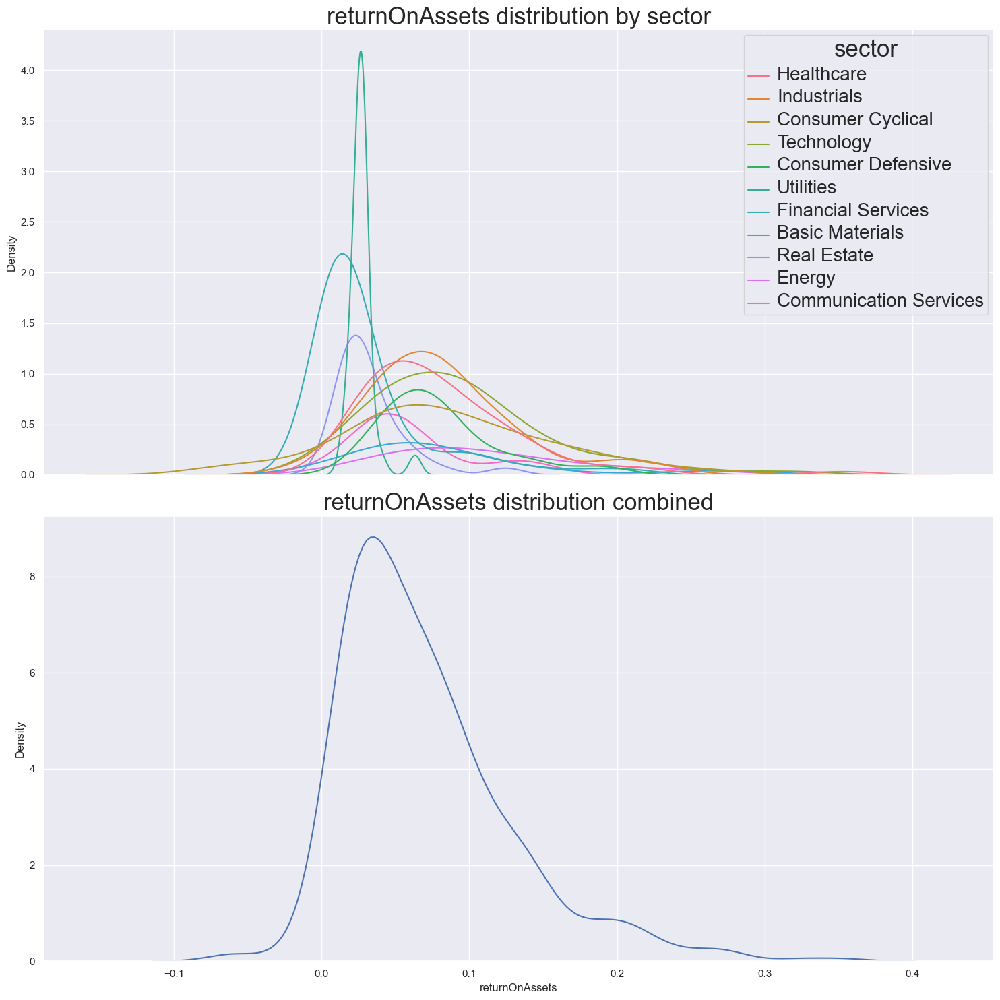

In [241]:
var = 'returnOnAssets'
display(df_numTypesUpdated[var].describe())
f, axs = plt.subplots(2,1, figsize=(15, 15),
                      sharex=True)
axs_0 = sns.kdeplot(data=df_numTypesUpdated, x=var, hue='sector', ax=axs[0]);
plt.setp(axs_0.get_legend().get_texts(), fontsize='20');
plt.setp(axs_0.get_legend().get_title(), fontsize='25');
axs_0.set_title(f'{var} distribution by sector', fontsize=25); 
axs_1 = sns.kdeplot(data=df_numTypesUpdated, x=var, ax=axs[1]);
axs_1.set_title(f'{var} distribution combined', fontsize=25); 
f.tight_layout();

In [246]:
f.savefig(f'C:/Users/49176/Desktop/DSA/OPA_repo/figures/{var}_distribution.png', dpi=250)

C:\Users\49176\AppData\Local\Temp\ipykernel_18868\3006144909.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f, axs = plt.subplots(2,1, figsize=(15, 15),


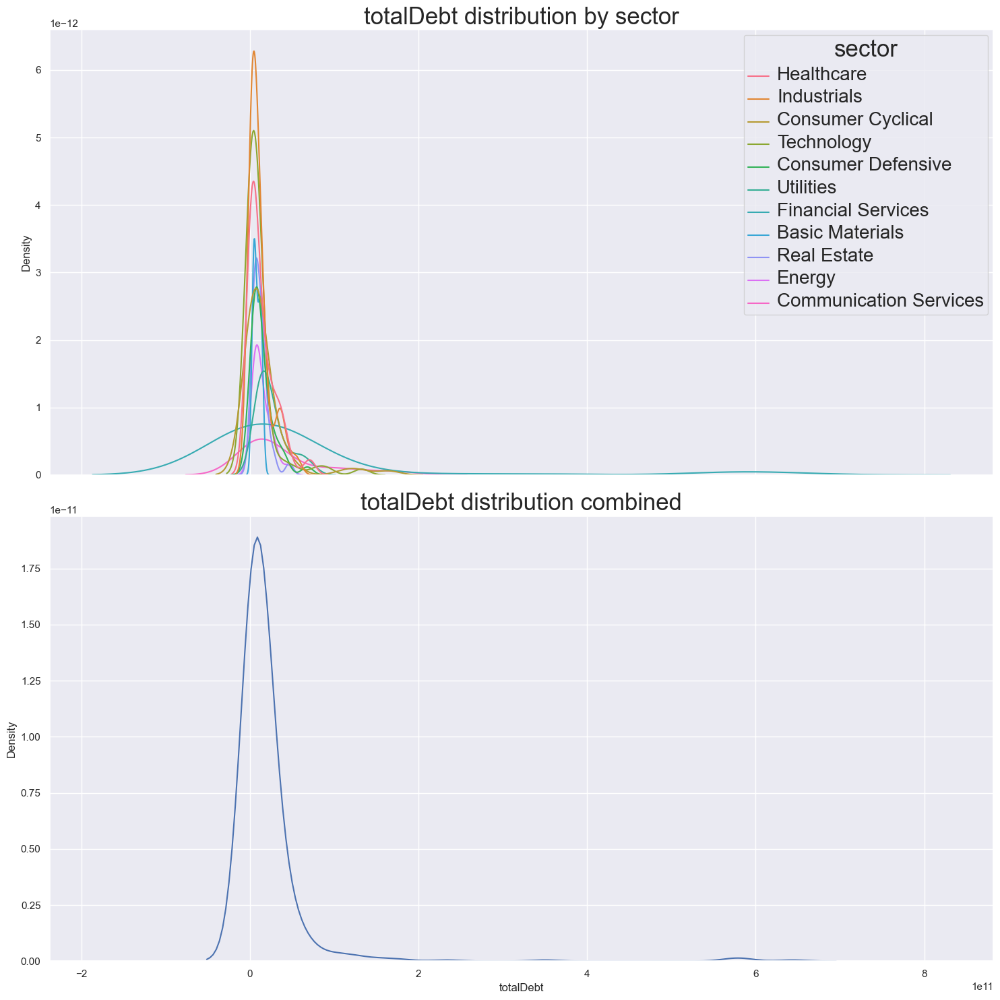

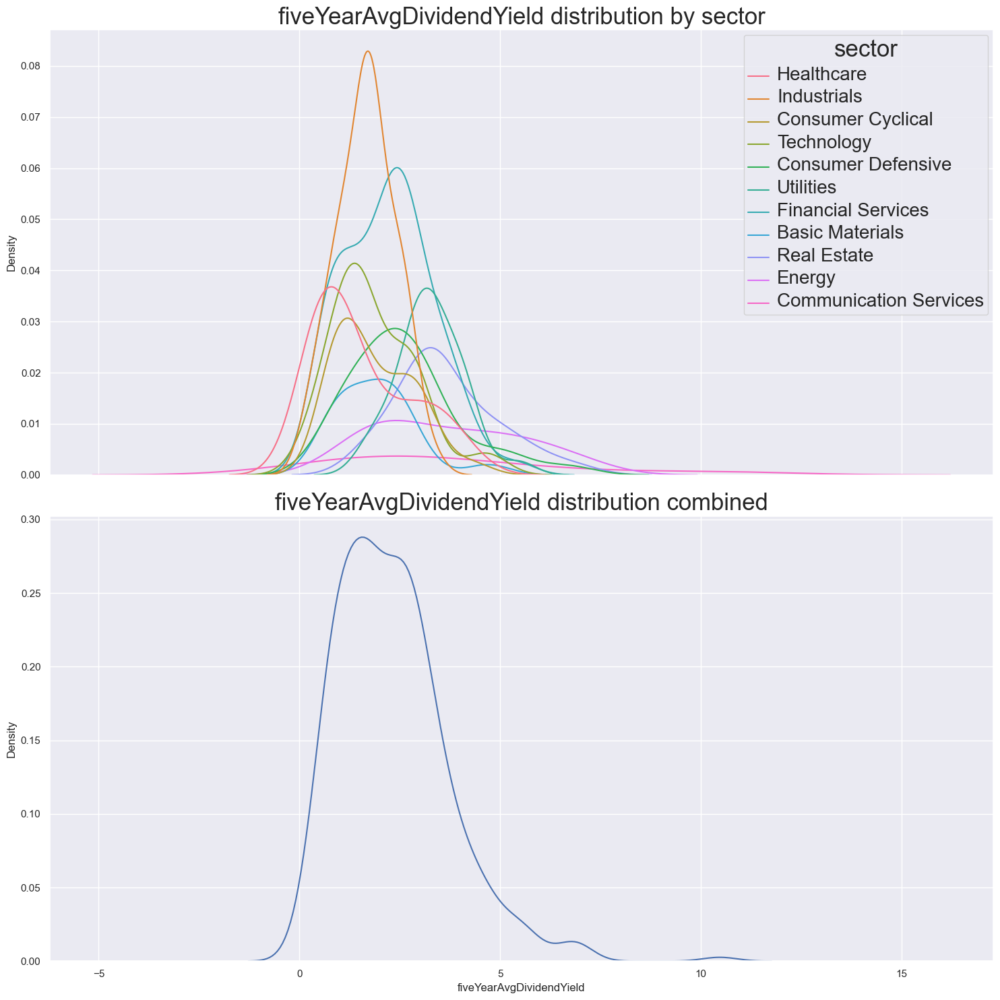

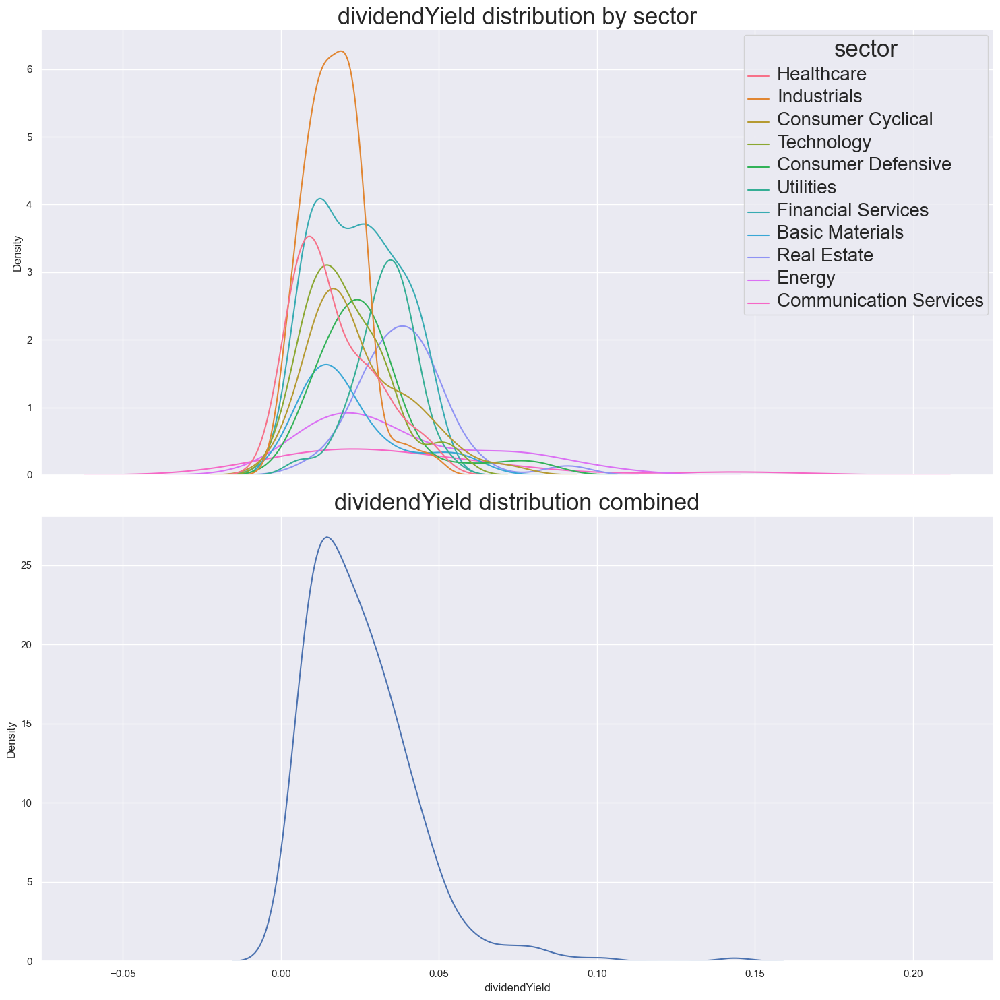

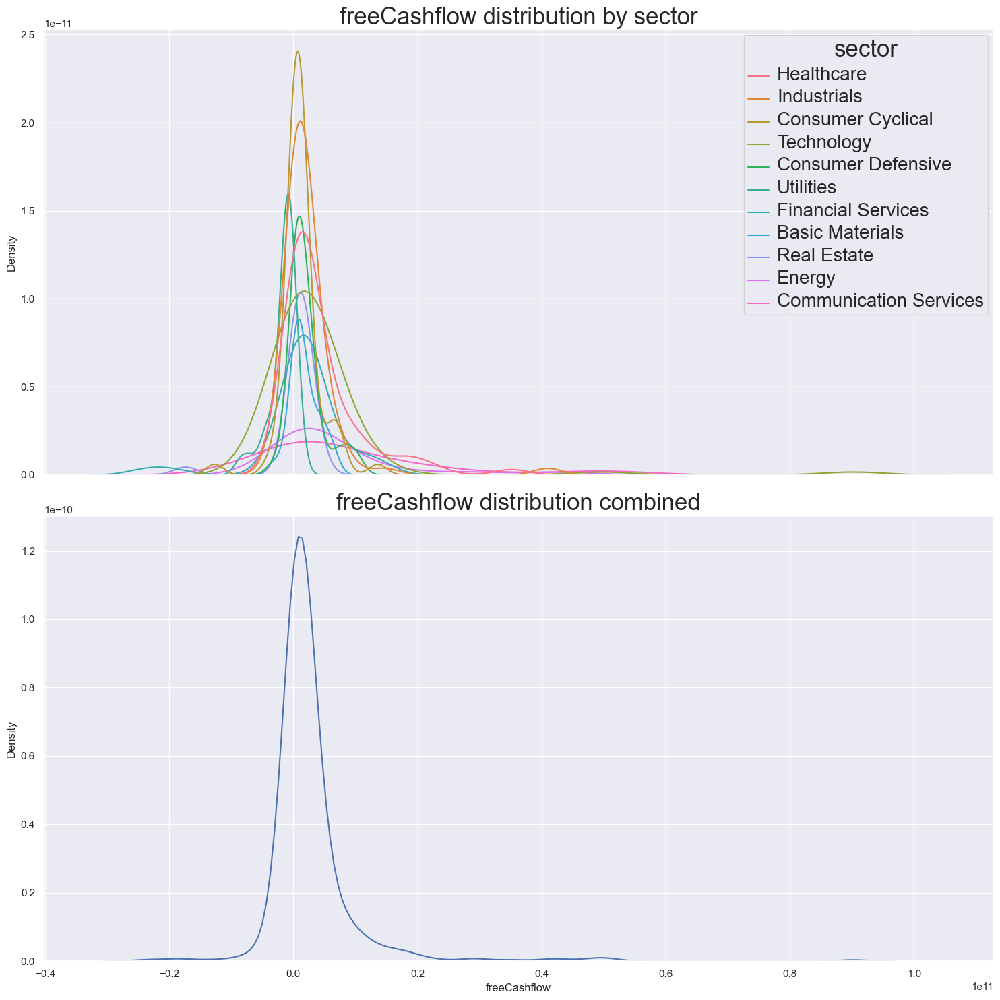

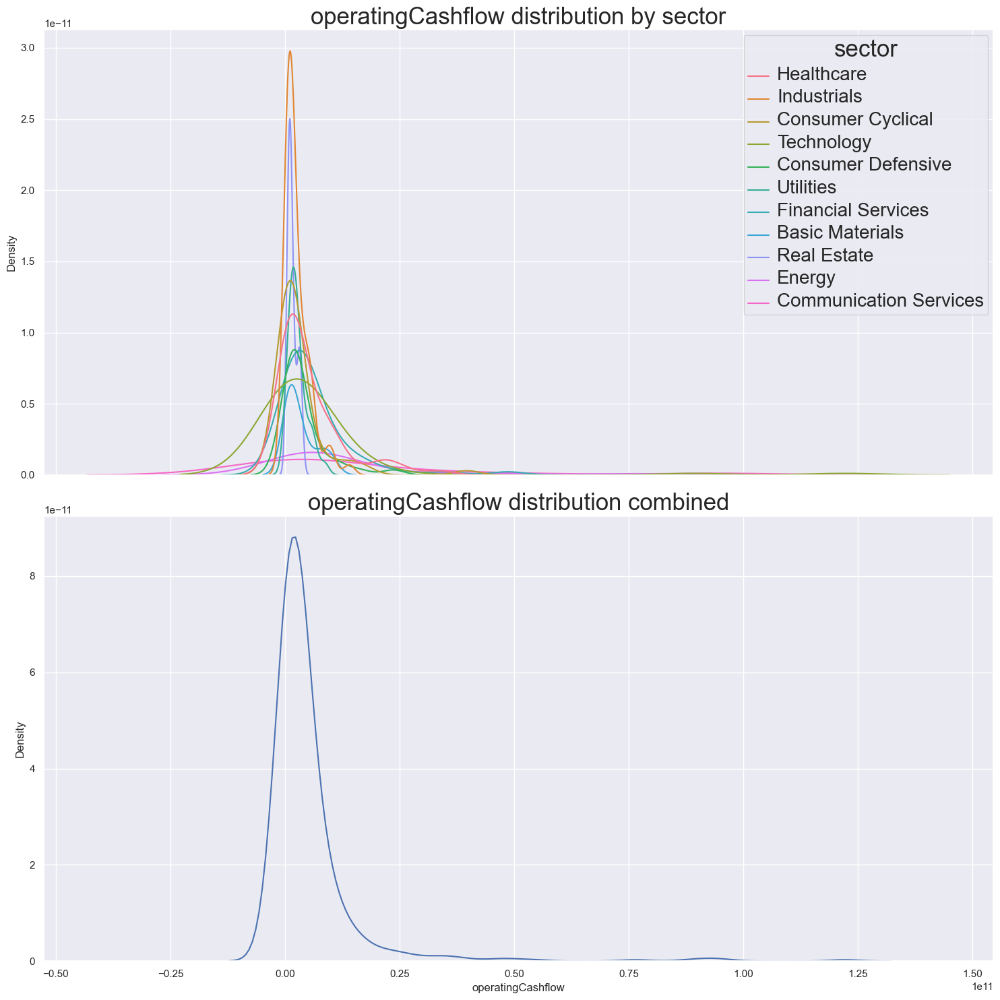

...

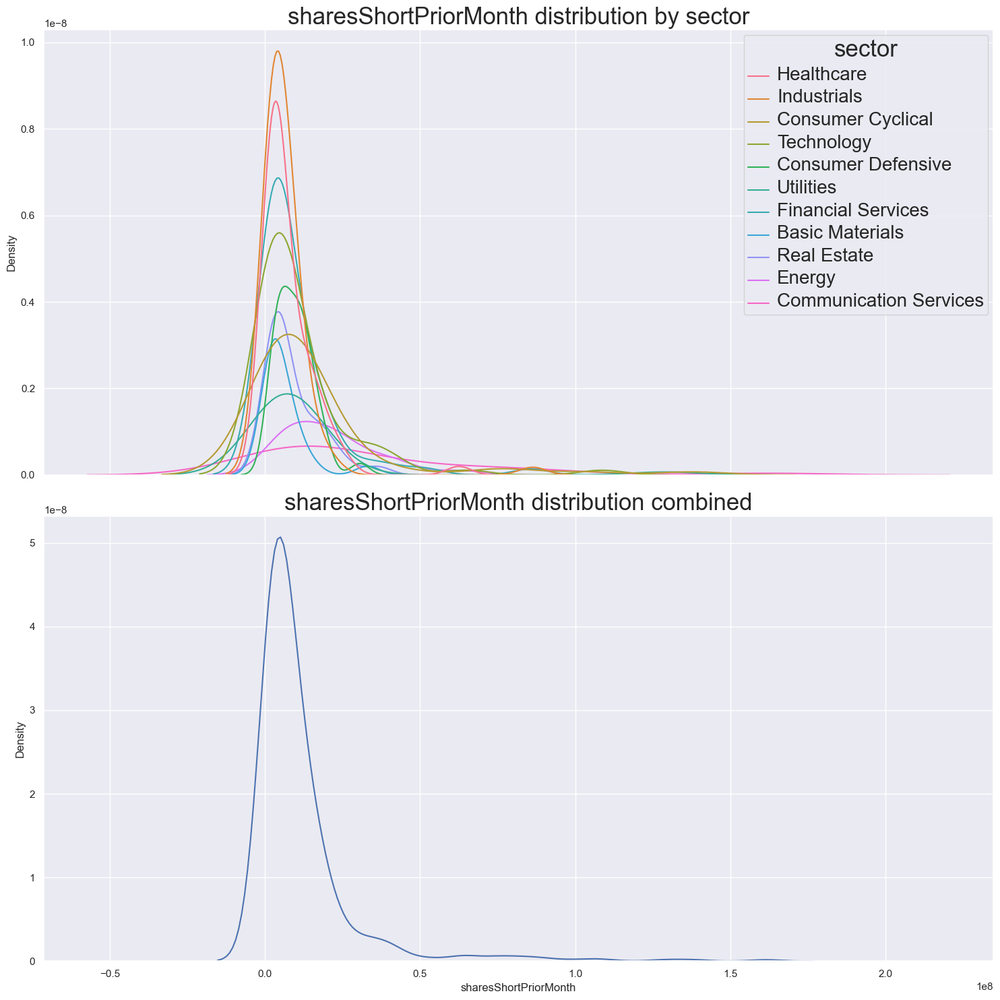

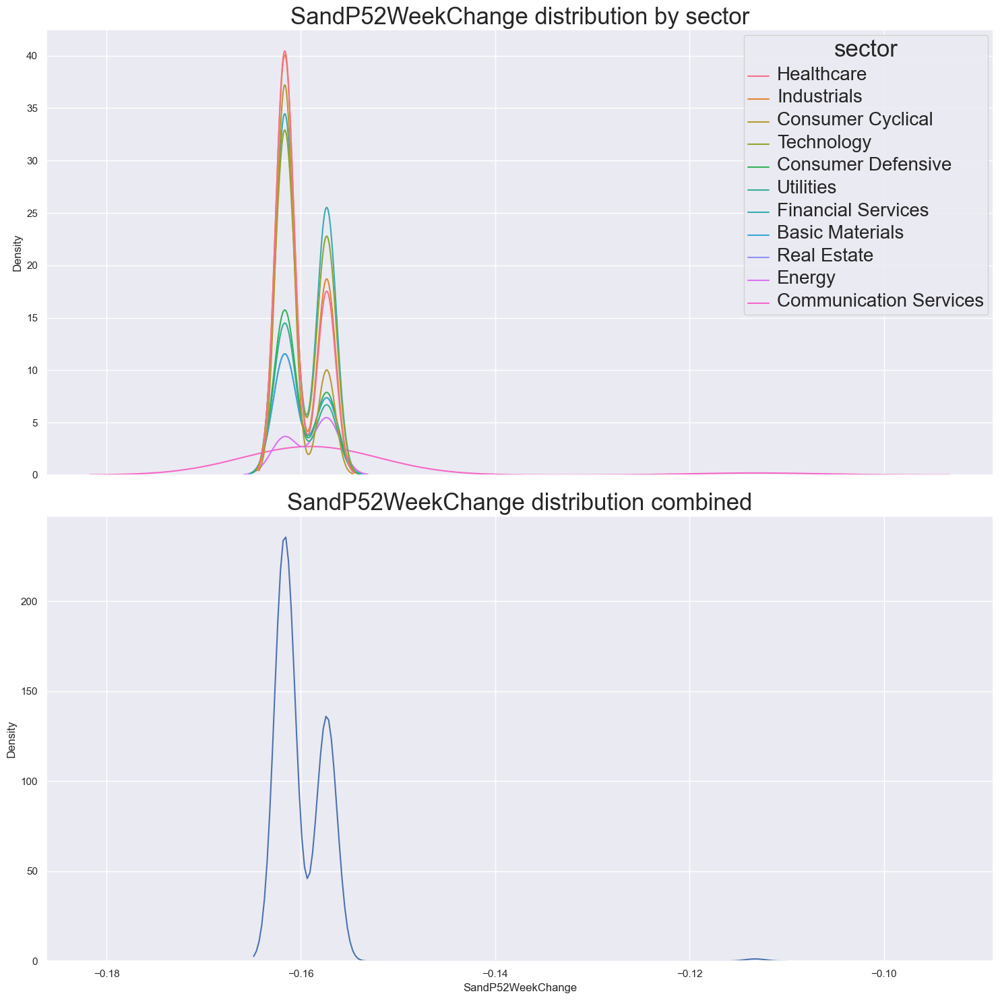

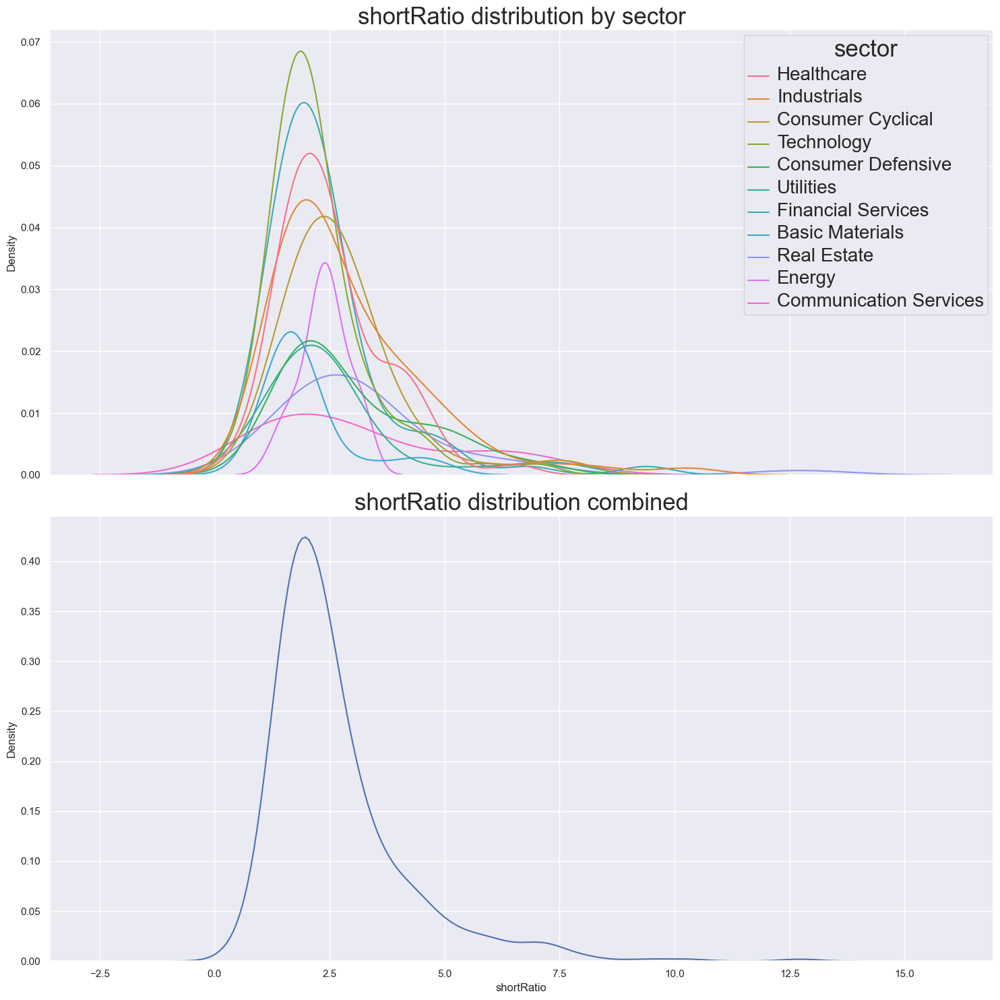

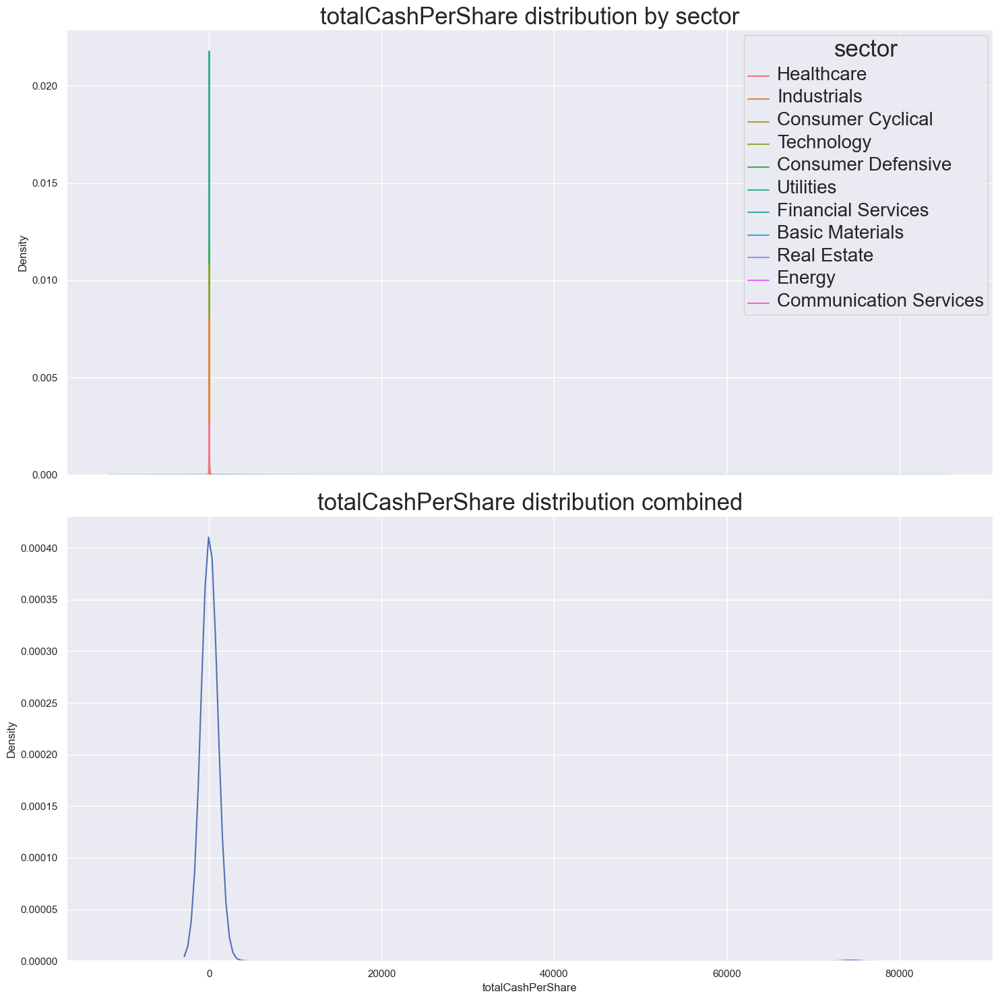

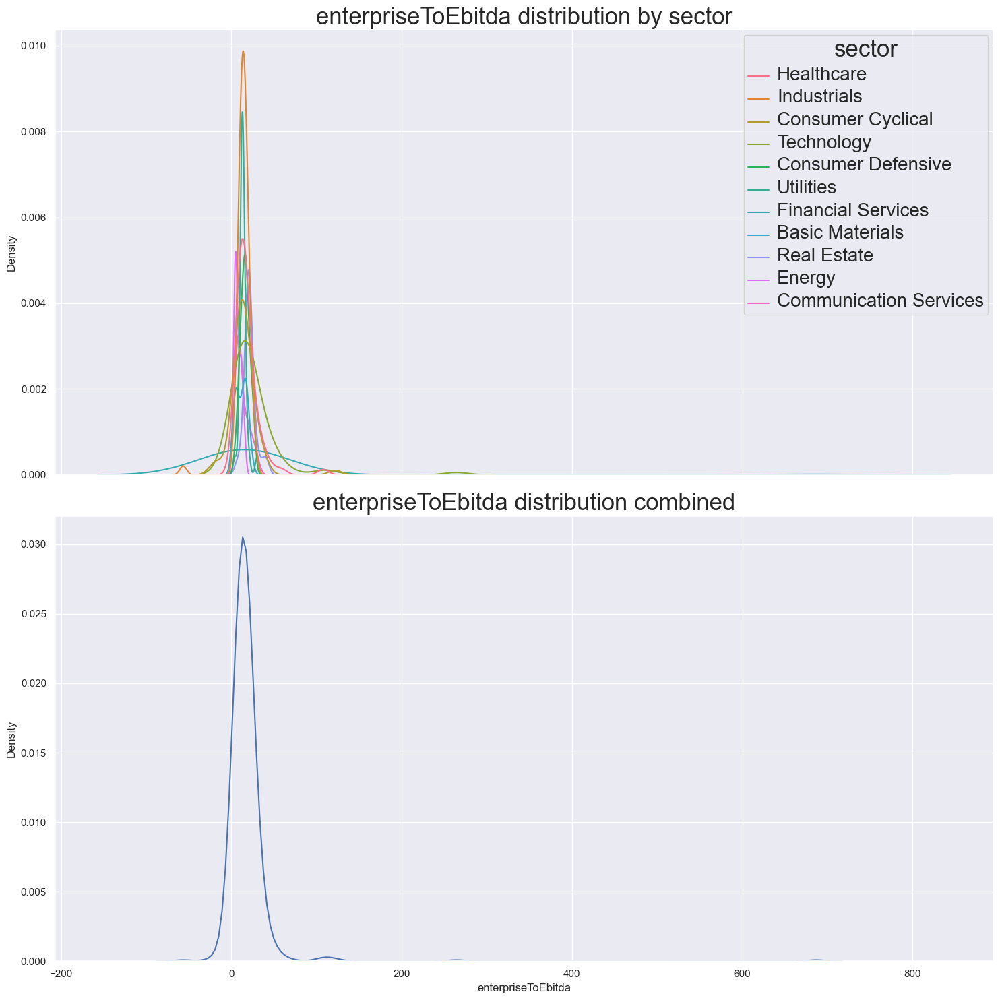

In [248]:
#automate the saving process
numeric_cols = df_numTypesUpdated.select_dtypes(include='float64').columns
for var in numeric_cols:
    f, axs = plt.subplots(2,1, figsize=(15, 15),
                      sharex=True)
    axs_0 = sns.kdeplot(data=df_numTypesUpdated, x=var, hue='sector', ax=axs[0]);
    plt.setp(axs_0.get_legend().get_texts(), fontsize='20');
    plt.setp(axs_0.get_legend().get_title(), fontsize='25');
    axs_0.set_title(f'{var} distribution by sector', fontsize=25); 
    axs_1 = sns.kdeplot(data=df_numTypesUpdated, x=var, ax=axs[1]);
    axs_1.set_title(f'{var} distribution combined', fontsize=25); 
    f.tight_layout();
    f.savefig(f'C:/Users/49176/Desktop/DSA/OPA_repo/figures/{var}_distribution.png', dpi=250)

Test if we can automate this for all the qualitative variables. However we decided to do t manually as there were just a selected few

In [ ]:
# #automate for qualitative vars as well
# non_num_cols = df_numTypesUpdated.select_dtypes(include='object').columns
# for qual_var in non_num_cols:
#     data = df_numTypesUpdated[qual_var].value_counts()
#     fig, ax = plt.pie(x=data.values, labels=data.index, autopct= lambda p: f'{p:.1f}% ({p*data.values.sum()/100:.0f})', pctdistance=0.8, radius=1.8);
#     centre_circle = plt.Circle((0, 0), 0.70, fc='white')
#     fig = plt.gcf()
#     plt.title(f'{qual_var} distribution', pad=100, fontsize=15);
#     fig.set_size_inches(12, 4);
#     fig.legend(loc=1);
    
#     # Adding Circle in Pie chart
#     fig.gca().add_artist(centre_circle);
#     #not fit: city, industry, 
#     fig.savefig(f'C:/Users/49176/Desktop/DSA/OPA_repo/figures/{qual_var}_distribution.png', dpi=250)

pair plots for numerical attributes

In [3]:
df_numTypesUpdated = pd.read_pickle(r'C:\Users\49176\Desktop\DSA\OPA_repo\df_allInfo_clean_typesCorrected.pkl')

In [10]:
df_numTypesUpdated.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 503 entries, 0 to 502
Data columns (total 76 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   symbol                        503 non-null    object 
 1   recommendationKey             503 non-null    object 
 2   industry                      503 non-null    object 
 3   shortName                     503 non-null    object 
 4   country                       503 non-null    object 
 5   exchange                      503 non-null    object 
 6   city                          503 non-null    object 
 7   sector                        503 non-null    object 
 8   currency                      502 non-null    object 
 9   numberOfAnalystOpinions       489 non-null    object 
 10  state                         482 non-null    object 
 11  lastSplitFactor               383 non-null    object 
 12  totalDebt                     498 non-null    float64
 13  fiveY

Finding correlation amonst numerical variables to genrate a heatmap

In [104]:
df_numTypesUpdated.select_dtypes(include='float64').corr() #will make a heatmap below

,totalDebt,fiveYearAvgDividendYield,dividendYield,freeCashflow,operatingCashflow,lastDividendValue,totalRevenue,sharesOutstanding,netIncomeToCommon,trailingPegRatio,...,profitMargins,pegRatio,fiftyTwoWeekLow,beta,fullTimeEmployees,sharesShortPriorMonth,SandP52WeekChange,shortRatio,totalCashPerShare,enterpriseToEbitda
totalDebt,1.000000,0.094643,0.117784,0.333318,0.322377,0.059813,0.291334,0.429909,0.346251,0.584592,...,0.045954,0.084017,-0.036169,0.021469,0.242548,0.301808,0.004877,-0.107489,0.095443,-0.087542
fiveYearAvgDividendYield,0.094643,1.000000,0.773116,0.010234,0.096221,0.155443,0.056028,0.144057,0.051270,-0.038099,...,0.031423,-0.044963,-0.396949,-0.002265,-0.044833,0.396010,0.055999,0.162037,-0.019975,-0.043837
dividendYield,0.117784,0.773116,1.000000,-0.069539,0.038619,0.205354,-0.022450,0.106723,0.013654,-0.004918,...,0.075309,-0.006817,-0.353236,-0.043543,-0.048154,0.379970,0.049792,0.194100,0.018743,-0.056971
freeCashflow,0.333318,0.010234,-0.069539,1.000000,0.804443,0.031717,0.510437,0.625958,0.833638,-0.049769,...,0.089907,0.002923,0.043309,-0.021010,0.100004,0.335025,-0.024704,-0.159852,-0.158579,-0.038135
operatingCashflow,0.322377,0.096221,0.038619,0.804443,1.000000,0.047885,0.696577,0.712270,0.929962,-0.018891,...,0.106329,-0.044222,0.021526,-0.031688,0.284649,0.396769,0.019482,-0.169023,0.123973,-0.053663
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
sharesShortPriorMonth,0.301808,0.396010,0.379970,0.335025,0.396769,-0.115007,0.326284,0.654517,0.384047,0.257354,...,-0.067037,-0.063698,-0.190706,0.142661,0.173865,1.000000,0.025708,0.102943,-0.013429,-0.064544
SandP52WeekChange,0.004877,0.055999,0.049792,-0.024704,0.019482,0.019480,0.011289,-0.014126,0.001298,-0.084927,...,0.021895,-0.013517,-0.048954,0.046691,0.007316,0.025708,1.000000,0.102083,0.045393,-0.015186
shortRatio,-0.107489,0.162037,0.194100,-0.159852,-0.169023,0.121549,-0.154858,-0.166053,-0.145764,0.012586,...,0.016992,-0.021776,-0.030293,-0.055238,-0.123677,0.102943,0.102083,1.000000,-0.041744,0.049336
totalCashPerShare,0.095443,-0.019975,0.018743,-0.158579,0.123973,0.105686,0.194909,0.023536,-0.021843,0.139084,...,-0.034247,-0.002022,0.035235,-0.012595,0.098617,-0.013429,0.045393,-0.041744,1.000000,-0.021728


pair plot for some selected numerical varaiables. Quite time intensive.

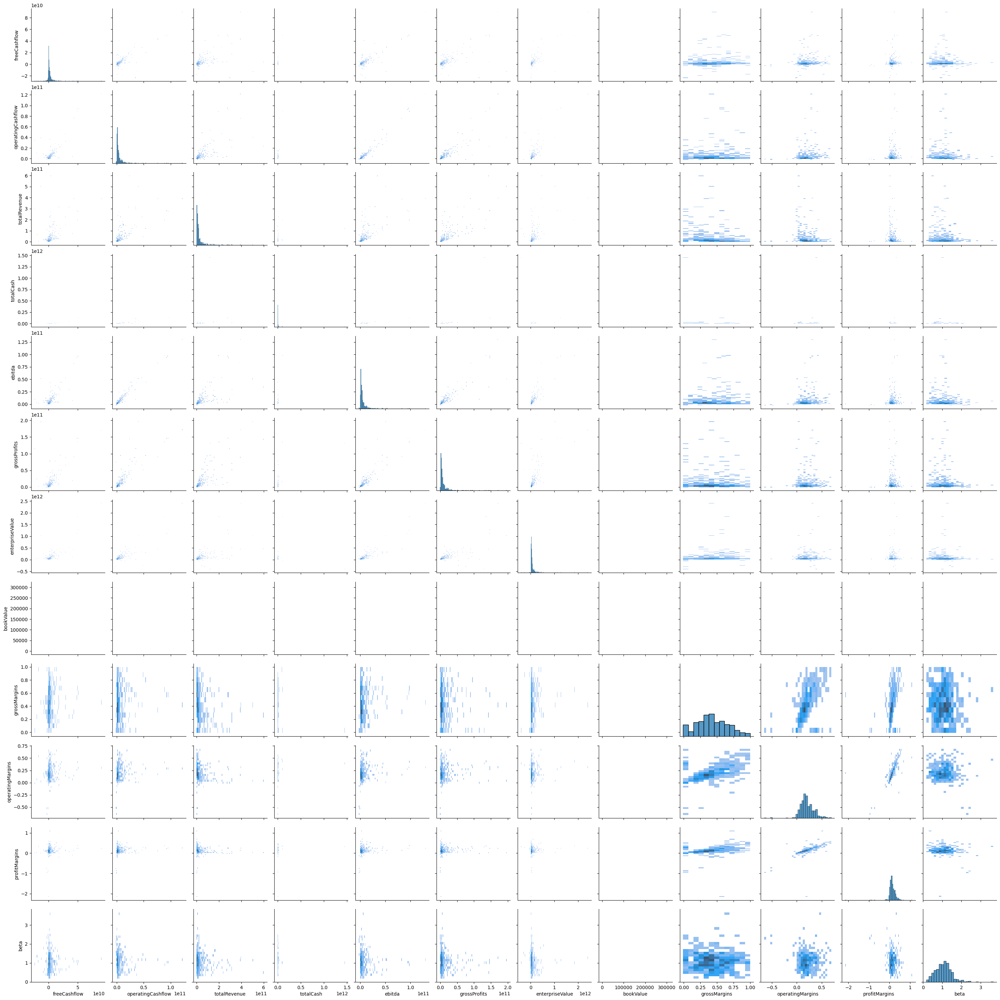

In [12]:
data = df_numTypesUpdated.select_dtypes(include='float64')[['freeCashflow', 'operatingCashflow', 'totalRevenue',
'totalCash', 'ebitda', 'grossProfits', 'enterpriseValue', 'bookValue', 'grossMargins', 'operatingMargins', 'profitMargins', 'beta']]
sns.pairplot(data, kind="hist") #time complex - run with selected vars

Heatmap generation

<AxesSubplot: >

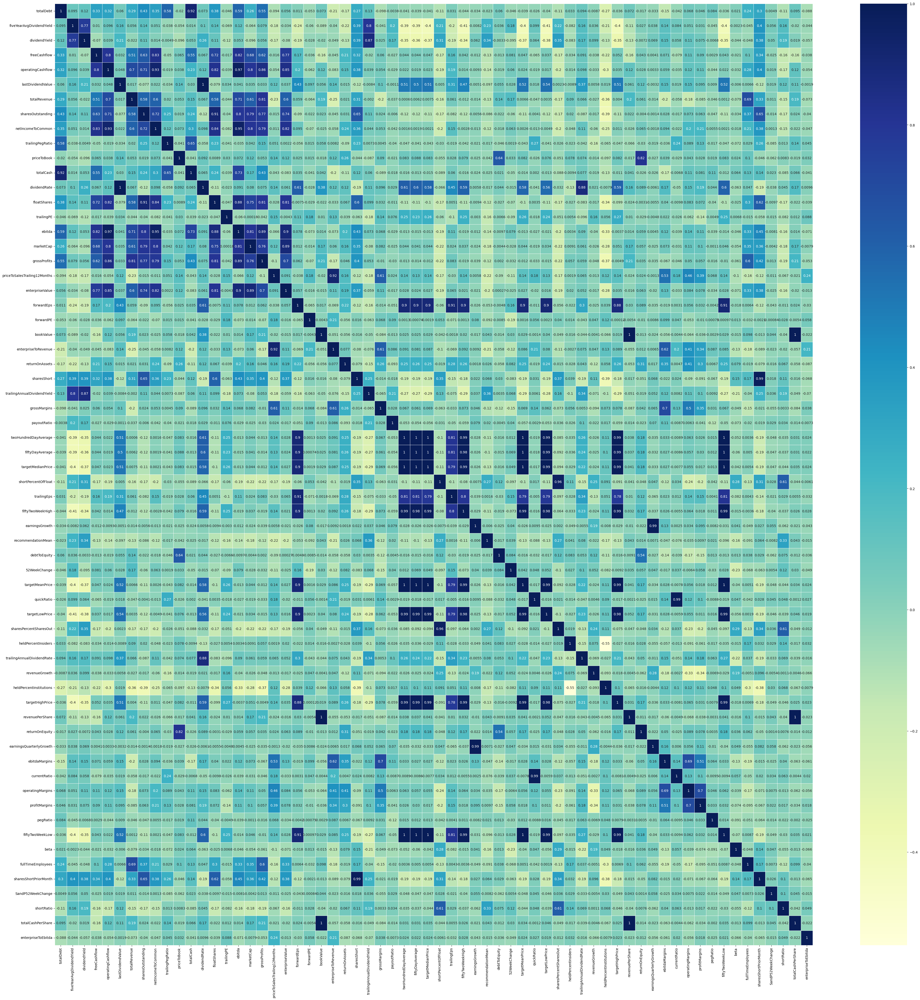

In [9]:
fig, ax = plt.subplots(figsize=(50,50))
sns.heatmap(df_numTypesUpdated.select_dtypes(include='float64').corr(), annot=True, linewidths=.5, cmap="YlGnBu", ax=ax)